<a href="https://colab.research.google.com/github/abdohamdyy/Leaf-Disease-Classification-using-Pretrained-ResNet-50/blob/main/New_Plant_Diseases.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install -q kaggle
from google.colab import files

files.upload()

In [ ]:
! mkdir ~/.kaggle
! cp kaggle.json ~/.kaggle/

In [ ]:
! chmod 600 ~/.kaggle/kaggle.json

In [ ]:
! kaggle datasets download -d vipoooool/new-plant-diseases-dataset

Dataset URL: https://www.kaggle.com/datasets/vipoooool/new-plant-diseases-dataset
License(s): copyright-authors
 99% 2.67G/2.70G [00:29<00:00, 161MB/s]
100% 2.70G/2.70G [00:29<00:00, 97.9MB/s]


In [ ]:
! unzip new-plant-diseases-dataset.zip

Streaming output truncated to the last 5000 lines.
  inflating: new plant diseases dataset(augmented)/New Plant Diseases Dataset(Augmented)/valid/Strawberry___healthy/273a7a9e-18be-4b6a-976a-fa5ffd69b731___RS_HL 4366_90deg.JPG  
  inflating: new plant diseases dataset(augmented)/New Plant Diseases Dataset(Augmented)/valid/Strawberry___healthy/275f8963-f4f4-4903-962b-1da716725d08___RS_HL 4780_90deg.JPG  
  inflating: new plant diseases dataset(augmented)/New Plant Diseases Dataset(Augmented)/valid/Strawberry___healthy/275f8963-f4f4-4903-962b-1da716725d08___RS_HL 4780_new30degFlipLR.JPG  
  inflating: new plant diseases dataset(augmented)/New Plant Diseases Dataset(Augmented)/valid/Strawberry___healthy/27c2aaa4-de4b-4fb1-ba8d-14d4b24b2afa___RS_HL 4665.JPG  
  inflating: new plant diseases dataset(augmented)/New Plant Diseases Dataset(Augmented)/valid/Strawberry___healthy/27c2aaa4-de4b-4fb1-ba8d-14d4b24b2afa___RS_HL 4665_270deg.JPG  
  inflating: new plant diseases dataset(augmented)/New 

In [ ]:
import numpy as np
import pandas as pd
import os
import matplotlib.pyplot as plt
import tensorflow as tf # Import tensorflow explicitly
from tensorflow.keras.models import Sequential,load_model,Model
from tensorflow.keras.layers import Conv2D,MaxPool2D,AveragePooling2D,Dense,Flatten,ZeroPadding2D,BatchNormalization,Activation,Add,Input,Dropout,GlobalAveragePooling2D
from tensorflow.keras.optimizers import SGD
from tensorflow.keras.initializers import glorot_uniform
from tensorflow.keras.preprocessing.image import ImageDataGenerator # Import from tensorflow.keras
from tensorflow.keras.callbacks import ModelCheckpoint,EarlyStopping,ReduceLROnPlateau
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.applications.resnet50 import preprocess_input
%matplotlib inline
import cv2
from PIL import Image

Number of images of Raspberry___healthy: 1781 ||
Number of images of Cherry_(including_sour)___Powdery_mildew: 1683 ||
Number of images of Orange___Haunglongbing_(Citrus_greening): 2010 ||
Number of images of Tomato___Spider_mites Two-spotted_spider_mite: 1741 ||
Number of images of Grape___Esca_(Black_Measles): 1920 ||
Number of images of Corn_(maize)___Common_rust_: 1907 ||
Number of images of Soybean___healthy: 2022 ||
Number of images of Squash___Powdery_mildew: 1736 ||
Number of images of Blueberry___healthy: 1816 ||
Number of images of Potato___Late_blight: 1939 ||
Number of images of Potato___healthy: 1824 ||
Number of images of Tomato___Bacterial_spot: 1702 ||
Number of images of Apple___Apple_scab: 2016 ||
Number of images of Grape___Leaf_blight_(Isariopsis_Leaf_Spot): 1722 ||
Number of images of Pepper,_bell___healthy: 1988 ||
Number of images of Apple___Black_rot: 1987 ||
Number of images of Potato___Early_blight: 1939 ||
Number of images of Strawberry___healthy: 1824 ||
Num

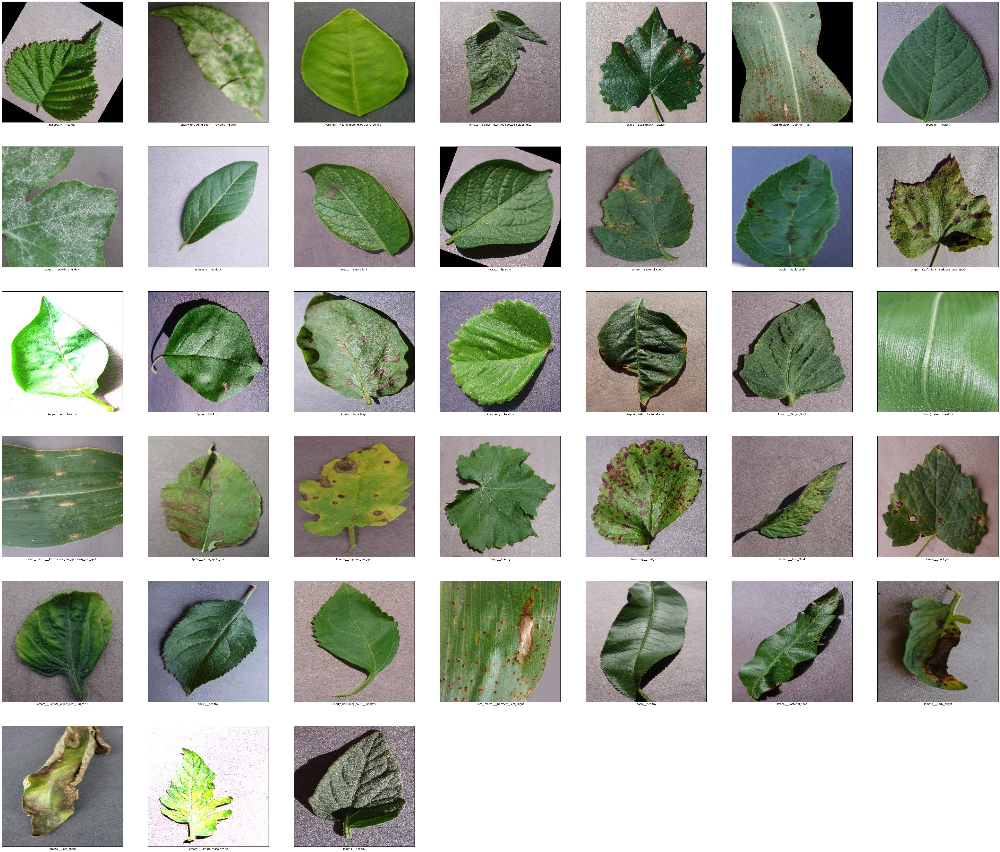

In [ ]:
path= "New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/train"
plt.figure(figsize=(70,70))
count=0
plant_names=[]
total_images=0
for i in os.listdir(path):
  count+=1
  plant_names.append(i)
  plt.subplot(7,7,count)

  images_path=os.listdir(path+"/"+i)
  print("Number of images of "+i+":",len(images_path),"||",end="\n")
  total_images+=len(images_path)

  image_show=plt.imread(path+"/"+i+"/"+images_path[0])

  plt.imshow(image_show)
  plt.xlabel(i)

  plt.xticks([])
  plt.yticks([])


print("Total number of images we have",total_images)


In [ ]:
print(plant_names)
print(len(plant_names))

['Raspberry___healthy', 'Cherry_(including_sour)___Powdery_mildew', 'Orange___Haunglongbing_(Citrus_greening)', 'Tomato___Spider_mites Two-spotted_spider_mite', 'Grape___Esca_(Black_Measles)', 'Corn_(maize)___Common_rust_', 'Soybean___healthy', 'Squash___Powdery_mildew', 'Blueberry___healthy', 'Potato___Late_blight', 'Potato___healthy', 'Tomato___Bacterial_spot', 'Apple___Apple_scab', 'Grape___Leaf_blight_(Isariopsis_Leaf_Spot)', 'Pepper,_bell___healthy', 'Apple___Black_rot', 'Potato___Early_blight', 'Strawberry___healthy', 'Pepper,_bell___Bacterial_spot', 'Tomato___Target_Spot', 'Corn_(maize)___healthy', 'Corn_(maize)___Cercospora_leaf_spot Gray_leaf_spot', 'Apple___Cedar_apple_rust', 'Tomato___Septoria_leaf_spot', 'Grape___healthy', 'Strawberry___Leaf_scorch', 'Tomato___Leaf_Mold', 'Grape___Black_rot', 'Tomato___Tomato_Yellow_Leaf_Curl_Virus', 'Apple___healthy', 'Cherry_(including_sour)___healthy', 'Corn_(maize)___Northern_Leaf_Blight', 'Peach___healthy', 'Peach___Bacterial_spot', 'T

In [ ]:
base_model_tf=ResNet50(include_top=False,weights='imagenet',input_shape=(224,224,3),classes=38)


94765736/94765736 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step


In [ ]:
#Model building
base_model_tf.trainable=False

pt=Input(shape=(224,224,3))

# Wrap the cast operation in a Lambda layer
x = tf.keras.layers.Lambda(lambda x: tensorflow.cast(x, tensorflow.float32))(pt)

x=preprocess_input(x) #This function used to zero-center each color channel wrt Imagenet dataset
model_resnet=base_model_tf(x,training=False)
model_resnet=GlobalAveragePooling2D()(model_resnet)
model_resnet=Dense(128,activation='relu')(model_resnet)
model_resnet=Dense(64,activation='relu')(model_resnet)
model_resnet=Dense(38,activation='softmax')(model_resnet)


model_main=Model(inputs=pt,outputs=model_resnet)
model_main.summary()

Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_2             │ (None, 224, 224, 3)    │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ lambda (Lambda)           │ (None, 224, 224, 3)    │              0 │ input_layer_2[0][0]    │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ get_item (GetItem)        │ (None, 224, 224)       │              0 │ lambda[0][0]           │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ get_item_1 (GetItem)      │ (None, 224, 224)       │              0 │ lambda[0][0]           │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ get_item_2 (GetItem)      │ (None, 224, 224)       │              0 │ lambda[0][0]           │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ stack (Stack)             │ (None, 224, 224, 3)    │              0 │ get_item[0][0],        │
│                           │                        │                │ get_item_1[0][0],      │
│                           │                        │                │ get_item_2[0][0]       │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ add (Add)                 │ (None, 224, 224, 3)    │              0 │ stack[0][0]            │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ resnet50 (Functional)     │ (None, 7, 7, 2048)     │     23,587,712 │ add[0][0]              │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ global_average_pooling2d  │ (None, 2048)           │              0 │ resnet50[0][0]         │
│ (GlobalAveragePooling2D)  │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense (Dense)             │ (None, 128)            │        262,272 │ global_average_poolin… │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_1 (Dense)           │ (None, 64)             │          8,256 │ dense[0][0]            │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ dense_2 (Dense)           │ (None, 38)             │          2,470 │ dense_1[0][0]          │
└───────────────────────────┴────────────────────────┴────────────────┴────────────────────────┘

 Total params: 23,860,710 (91.02 MB)

 Trainable params: 272,998 (1.04 MB)

 Non-trainable params: 23,587,712 (89.98 MB)

In [ ]:
#Image augmentation
train_datagen= ImageDataGenerator(shear_range=0.2,zoom_range=0.2,horizontal_flip=False,vertical_flip=False
                                  ,fill_mode='nearest',width_shift_range=0.2,height_shift_range=0.2)

val_datagen=ImageDataGenerator()

path_train='New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/train'

path_valid='New Plant Diseases Dataset(Augmented)/New Plant Diseases Dataset(Augmented)/valid'

train= train_datagen.flow_from_directory(directory=path_train,batch_size=32,target_size=(224,224),
                                         color_mode='rgb',class_mode='categorical',seed=42)

valid=val_datagen.flow_from_directory(directory=path_valid,batch_size=32,target_size=(224,224),color_mode='rgb',class_mode='categorical')

Found 70295 images belonging to 38 classes.
Found 17572 images belonging to 38 classes.


In [ ]:
#CallBacks
es=EarlyStopping(monitor='val_accuracy',verbose=1,patience=7,mode='auto')
mc=ModelCheckpoint(filepath='/content/model.keras',monitor='val_accuracy',verbose=1,save_best_only=True) # Added '.keras' extension to the filepath
lr=ReduceLROnPlateau(monitor='val_accuracy',verbose=1,patience=5,min_lr=0.001)

In [ ]:
model_main.compile(optimizer='Adam',loss='categorical_crossentropy',metrics=['accuracy'])


In [ ]:
model_main.fit(train,validation_data=valid,epochs=5,verbose=1,callbacks=[mc,es,lr])

Epoch 1/10
2197/2197 ━━━━━━━━━━━━━━━━━━━━ 0s 393ms/step - accuracy: 0.9174 - loss: 0.2558
Epoch 1: val_accuracy improved from -inf to 0.94816, saving model to /content/model.keras
2197/2197 ━━━━━━━━━━━━━━━━━━━━ 922s 419ms/step - accuracy: 0.9174 - loss: 0.2557 - val_accuracy: 0.9482 - val_loss: 0.1544 - learning_rate: 0.0010
Epoch 2/10
2197/2197 ━━━━━━━━━━━━━━━━━━━━ 0s 390ms/step - accuracy: 0.9552 - loss: 0.1337
Epoch 2: val_accuracy improved from 0.94816 to 0.95550, saving model to /content/model.keras
2197/2197 ━━━━━━━━━━━━━━━━━━━━ 943s 428ms/step - accuracy: 0.9552 - loss: 0.1337 - val_accuracy: 0.9555 - val_loss: 0.1349 - learning_rate: 0.0010
Epoch 3/10
2197/2197 ━━━━━━━━━━━━━━━━━━━━ 0s 387ms/step - accuracy: 0.9604 - loss: 0.1179
Epoch 3: val_accuracy improved from 0.95550 to 0.95914, saving model to /content/model.keras
2197/2197 ━━━━━━━━━━━━━━━━━━━━ 899s 408ms/step - accuracy: 0.9604 - loss: 0.1179 - val_accuracy: 0.9591 - val_loss: 0.1252 - learning_rate: 0.0010
Epoch 4/10
21